# Main Capstone Project Notebook

# Accident Analysis in the “Hauts-de-Seine” department

## Table of Contents

<div class="alert alert-block alert-info" style="margin-top: 20px">

1. Data collection and pre processing<br>
2. Evolution of the number of accident from 2006 to 2018<br>
3. Explore the top 3 towns with Foursquare<br>
4. Clustering with KMeans<br>
5. Map of alcohol accident lethal accident <br>

</div>
<hr>

import section

In [26]:
import pandas as pd
import numpy as np
import requests

# Matplotlib and associated plotting modules
import matplotlib.cm as cm
import matplotlib.colors as colors
import matplotlib as mpl
import matplotlib.pyplot as plt

%matplotlib inline 

import folium
from folium import plugins

from geopy.geocoders import Nominatim

from datetime import datetime

import json


# Data collection and pre-processing

### Load the Data File containing the information about acccident in the Haut-de-Seinr from 2006 to 2018

In [27]:
df_accident = pd.read_csv('accidents-corporels-de-la-circulation-routiere.csv',sep=';',encoding='utf-8')
df_accident.head()

,geo_point_2d,ID_PV,DATE_,HEURE,CODE_INSEE,COMMUNE,LIEU,LUMINOSITE,COND_ATMOS,TYPE_COLLI,...,NB_TC_BH,NB_TC_T,CAT_VE5,ROUTE_VE5,SENS_VE5,MAN_VE5,NB_T_VE5,NB_BH_VE5,NB_BNH_VE5,geo_shape
0,"48.8875074156,2.2330050853",Sécurité publique 0092062 00930,2008-04-15,15:00,92062,Puteaux,Intersection en X,Plein jour,Normales,Collision par le côté,...,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"{""type"": ""Point"", ""coordinates"": [2.2330050853..."
1,"48.8796764303,2.2360162598",Sécurité publique 0092062 00978,2008-04-30,18:20,92062,Puteaux,Hors intersection,Plein jour,Normales,Sans collision,...,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"{""type"": ""Point"", ""coordinates"": [2.2360162597..."
2,"48.8807760247,2.23779962225",Sécurité publique 0092062 01309,2008-06-14,20:45,92062,Puteaux,Intersection en X,Plein jour,Normales,Collision par le côté,...,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"{""type"": ""Point"", ""coordinates"": [2.2377996222..."
3,"48.8864552637,2.25219630828",Sécurité publique 0092062 01353,2008-06-18,16:25,92062,Puteaux,Hors intersection,Plein jour,Normales,Sans collision,...,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"{""type"": ""Point"", ""coordinates"": [2.2521963082..."
4,"48.8782634548,2.24267820399",Sécurité publique 0092062 01365,2008-06-20,22:20,92062,Puteaux,Intersection en X,Nuit avec éclairage public allumé,Normales,Collision par l'arrière,...,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"{""type"": ""Point"", ""coordinates"": [2.2426782039..."


Creation of a YEAR column in order plot the evolution of the number of accident from 2006 to 2017.
Coorection of the name of several town

In [28]:
#get the year of the accident
df_accident['YEAR'] = df_accident['DATE_'].map(lambda s: datetime.strptime(s, '%Y-%m-%d').year)
df_accident['YEAR'].apply(lambda v: int(v))

#create a datetime from the DATE_ and HEURE column and create the DATE_1 column
df_date=df_accident[['DATE_','HEURE']]
df_date.head()

date1 = df_accident['DATE_'].map(lambda s: datetime.strptime(s, '%Y-%m-%d'))
date2 = df_accident['HEURE'].map(lambda s: datetime.strptime(s, '%H:%M'))
date3 = []

for v1,v2 in zip(date1,date2):
    date3.append(datetime(v1.year, v1.month, v1.day, v2.hour,v2.minute))
    
df_accident.insert(2, 'DATE_1',date3)
df_accident.head()

#correction on town names to avoid doublon and for compatibility with GEOJson
df_accident['COMMUNE'].replace('Ville d\'Avray','Ville-d\'Avray',inplace=True)
df_accident['COMMUNE'].replace('La Garenne-Colombes','Garenne-Colombes',inplace=True)
df_accident['COMMUNE'].replace('Le Plessis-Robinson','Plessis-Robinson',inplace=True)


Read the latitude and longitude of the accident and create the corresponding column

In [29]:
# a function that split the geo_point_2d string to get latitude and longitude
def getCoords(s):
    tokens = str.split(s,',')
    lat = float(tokens[0])
    lng = float(tokens[1])
    return lat,lng


#read the geo_point_2d column and extract the coord
lats = []
lngs=[]

res1= df_accident['geo_point_2d'].map(getCoords)
for tpl in res1:
    lats.append(tpl[0])
    lngs.append(tpl[1])

#Latitude & Longitude columne creation
df_accident['Latitude']=lats
df_accident['Longitude']=lngs
df_accident.head(3)


,geo_point_2d,ID_PV,DATE_1,DATE_,HEURE,CODE_INSEE,COMMUNE,LIEU,LUMINOSITE,COND_ATMOS,...,ROUTE_VE5,SENS_VE5,MAN_VE5,NB_T_VE5,NB_BH_VE5,NB_BNH_VE5,geo_shape,YEAR,Latitude,Longitude
0,"48.8875074156,2.2330050853",Sécurité publique 0092062 00930,2008-04-15 15:00:00,2008-04-15,15:00,92062,Puteaux,Intersection en X,Plein jour,Normales,...,NaN,NaN,NaN,NaN,NaN,NaN,"{""type"": ""Point"", ""coordinates"": [2.2330050853...",2008,48.887507,2.233005
1,"48.8796764303,2.2360162598",Sécurité publique 0092062 00978,2008-04-30 18:20:00,2008-04-30,18:20,92062,Puteaux,Hors intersection,Plein jour,Normales,...,NaN,NaN,NaN,NaN,NaN,NaN,"{""type"": ""Point"", ""coordinates"": [2.2360162597...",2008,48.879676,2.236016
2,"48.8807760247,2.23779962225",Sécurité publique 0092062 01309,2008-06-14 20:45:00,2008-06-14,20:45,92062,Puteaux,Intersection en X,Plein jour,Normales,...,NaN,NaN,NaN,NaN,NaN,NaN,"{""type"": ""Point"", ""coordinates"": [2.2377996222...",2008,48.880776,2.237800


### Create a map to have a global overview of the accident localization

In [30]:
address = 'Nanterre, France'

geolocator = Nominatim(user_agent="Coursera_FinalAssignment")
location = geolocator.geocode(address)
latitude = location.latitude
longitude = location.longitude

map_hs = folium.Map(location=[latitude, longitude], zoom_start=12)

# instantiate a mark cluster object for the incidents in the dataframe
incidents = plugins.MarkerCluster().add_to(map_hs)

# loop through the dataframe and add each data point to the mark cluster
for lat, lng, label, in zip(df_accident['Latitude'], df_accident['Longitude'], df_accident['TYPE_COLLI']):
    folium.Marker(
        location=[lat, lng],
        icon=None,
        popup=label,
    ).add_to(incidents)

map_hs



## Number of accident by Year


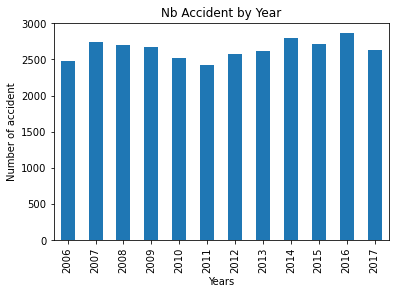

In [31]:
#plot number of accident by year
# byYears.plot(kind='bar')
df_accident['YEAR'].value_counts().sort_index().plot.bar()

plt.title('Nb Accident by Year')
plt.ylabel('Number of accident')
plt.xlabel('Years')

plt.show() # need this line to show the updates made to the figure


(36,)


Text(0.5, 0, 'Town')

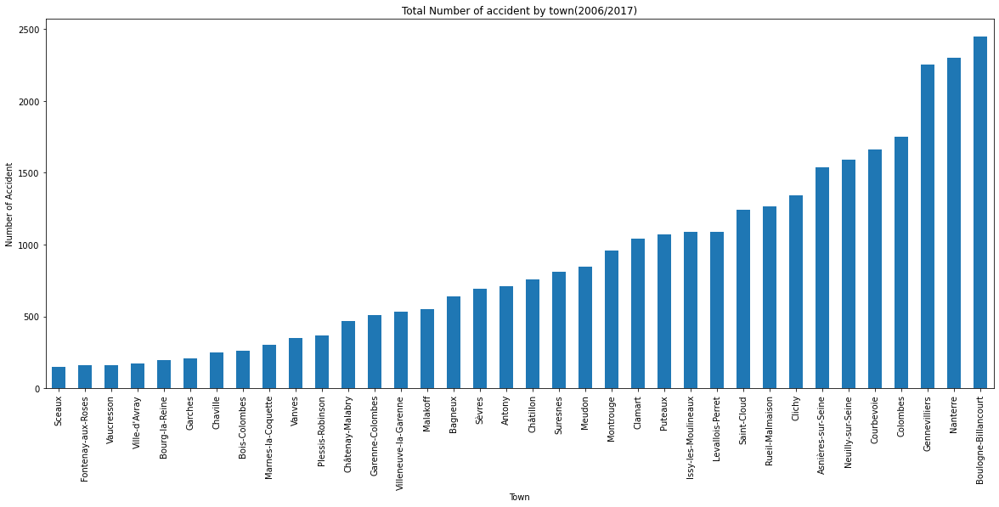

In [32]:
#plot by town and by year
towns = df_accident['COMMUNE'].unique()

print(towns.shape)

df_town=pd.DataFrame()
for town in towns:
    df_town[town] = df_accident[df_accident['COMMUNE']==town]['YEAR'].value_counts().sort_index()

#compute the total number of accident by town
tot = df_town.sum().sort_values()

tot.plot.bar(figsize=(20, 8))

plt.title('Total Number of accident by town(2006/2017)')
plt.ylabel('Number of Accident')
plt.xlabel('Town')

Display the same plot but only for the latest year (2017)
We can see that the top 3 towns are still the same.

Text(0.5, 0, 'Town')

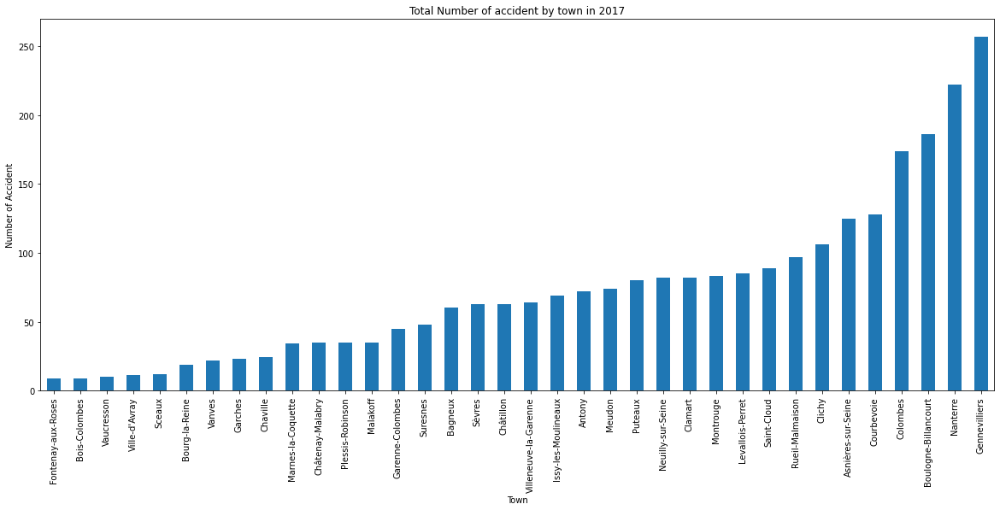

In [74]:
y2017 = df_town.loc[2017].sort_values()
#print(y2017.sort_values())
y2017.plot.bar(figsize=(20,8))

plt.title('Total Number of accident by town in 2017')
plt.ylabel('Number of Accident')
plt.xlabel('Town')

I load the GEOJson file with the town boundaries in order to draw a choroplet map

In [34]:
communities_geo = r'communes-92-hauts-de-seine.geojson' # geojson file

import json

# open the json file - json.load() methods returns a python dictionary
with open(communities_geo) as communities_file:
    communities_json = json.load(communities_file)
    
# we loop through the dictionary to obtain the name of the communities in the json file
denominations_json = []
for index in range(len(communities_json['features'])):
    denominations_json.append(communities_json['features'][index]['properties']['nom'])
    
#denominations_json

Creation of the choroplet map displaying the number of accident by town from 2006 to 2017

In [35]:
# generate choropleth map using the total immigration of each country to Canada from 1980 to 2013

map_choro = folium.Map(location=[latitude, longitude], zoom_start=11)

map_choro.choropleth(
    geo_data=communities_geo,
    data=y2017,
    key_on='feature.properties.nom',
    fill_color='YlOrRd', 
    fill_opacity=0.7, 
    line_opacity=0.2,
    legend_name='Number of accident 2006-2017'
)

# display map
map_choro

Plot the number of accident of the top 4 town during these years 2006-2017
We can see that 10 2011-2012 there was a decrease of the nnumber of accident. for most f the town.
Globally all this towns have an increase of their numbers of accient during this period. Maybe it's a consequence of the growth of the population in this area. 
Genneviliiers that have the most accidents seems to have a constant raise of it's number. 


Text(0.5, 0, 'Town')

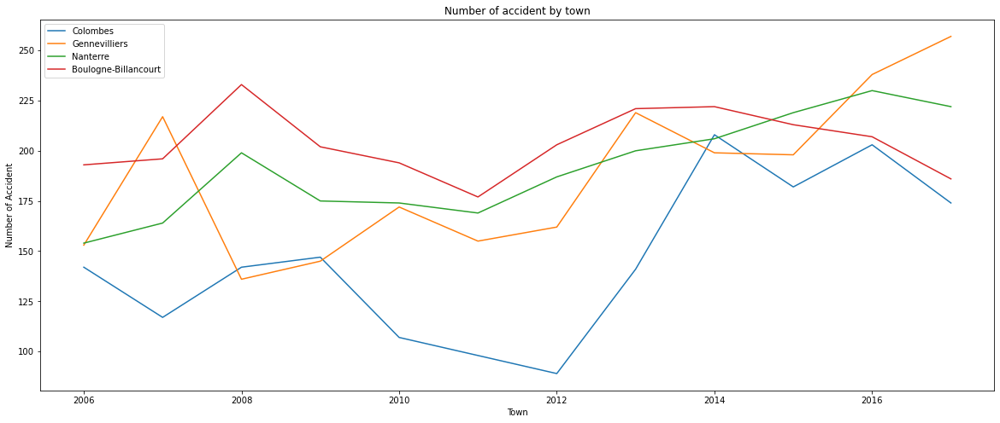

In [36]:
top4_town = tot.tail(4).index
df_top4 = df_town[top4_town]

df_top4.plot.line(figsize=(20,8))
plt.title('Number of accident by town')
plt.ylabel('Number of Accident')
plt.xlabel('Town')

# Explortation of the top 3 town with foursquare

In [62]:
def getLatLong(address):
    geolocator = Nominatim(user_agent="Coursra_FinalAssignment")
    location = geolocator.geocode(address)
    latitude = location.latitude
    longitude = location.longitude
    #print('The geograpical coordinate of Nanterre are {}, {}.'.format(latitude, longitude))
    return latitude,longitude

In [63]:
CLIENT_ID = 'WYCBJKQTTOGLP2DE3JZVMOEEHQX2LK0KLSZWADASUDKBM3TL' # your Foursquare ID
CLIENT_SECRET = 'LUXIEPZ1XOFLT4F3RQVCGY3WRP3VXGDLAFUYJ14WEUVJMUUE' # your Foursquare Secret
VERSION = '20180605' # Foursquare API version
LIMIT = 100

In [65]:
address1 = 'Nanterre, France'
lat1,lng1 = getLatLong(address1)
print('The geographical coordinate of {} are {}, {}.'.format(address1,lat1, lng1))

address2='Gennevilliers, France'
lat2,lng2 = getLatLong(address2)
print('The geographical coordinate of {} are {}, {}.'.format(address2,lat2, lng2))

address3='Boulogne-Billancourt, France'
lat3,lng3 = getLatLong(address3)
print('The geographical coordinate of {} are {}, {}.'.format(address3,lat3, lng3))

arCoordTown = np.array([['Nanterre',lat1,lng1],['Gennevilliers',lat2,lng2],['Boulogne-Billancourt',lat3,lng3]])

The geographical coordinate of Nanterre, France are 48.8924273, 2.2071267.
The geographical coordinate of Gennevilliers, France are 48.9254221, 2.2940122.
The geographical coordinate of Boulogne-Billancourt, France are 48.8356649, 2.240206.


In [66]:
def getNearbyVenues(names, latitudes, longitudes, radius=500):
    
    venues_list=[]
    for name, lat, lng in zip(names, latitudes, longitudes):
        print(name)
            
        # create the API request URL
        url = 'https://api.foursquare.com/v2/venues/explore?&client_id={}&client_secret={}&v={}&ll={},{}&radius={}&limit={}'.format(
            CLIENT_ID, 
            CLIENT_SECRET, 
            VERSION, 
            lat, 
            lng, 
            radius, 
            LIMIT)
            
        # make the GET request
        results = requests.get(url).json()["response"]['groups'][0]['items']
        
        # return only relevant information for each nearby venue
        venues_list.append([(
            name, 
            lat, 
            lng, 
            v['venue']['name'], 
            v['venue']['location']['lat'], 
            v['venue']['location']['lng'],  
            v['venue']['categories'][0]['name']) for v in results])

    nearby_venues = pd.DataFrame([item for venue_list in venues_list for item in venue_list])
    nearby_venues.columns = ['Neighborhood', 
                  'Neighborhood Latitude', 
                  'Neighborhood Longitude', 
                  'Venue', 
                  'Venue Latitude', 
                  'Venue Longitude', 
                  'Venue Category']
    
    return(nearby_venues)

In [67]:
#Nanterre venues
boroughs=pd.DataFrame(arCoordTown,columns=['Name','Latitude','Longitude'])

radius=2000

venues = getNearbyVenues(names=boroughs['Name'],
                                latitudes=boroughs['Latitude'],
                                longitudes=boroughs['Longitude'],
                                radius=radius)



Nanterre
Gennevilliers
Boulogne-Billancourt


In [70]:
cat1 = venues[venues['Neighborhood']=='Nanterre']['Venue Category'].value_counts()
cat1.head(5)

Hotel                  6
Plaza                  5
Japanese Restaurant    4
Supermarket            3
Park                   3
Name: Venue Category, dtype: int64

In [71]:
cat2 = venues[venues['Neighborhood']=='Gennevilliers']['Venue Category'].value_counts()
cat2.head(5)

Hotel                     7
Supermarket               7
Furniture / Home Store    3
Japanese Restaurant       3
Sporting Goods Shop       2
Name: Venue Category, dtype: int64

In [72]:
cat3 = venues[venues['Neighborhood']=='Boulogne-Billancourt']['Venue Category'].value_counts()
cat3.head(5)

French Restaurant     20
Tennis Court          10
Italian Restaurant     7
Bakery                 5
Bistro                 4
Name: Venue Category, dtype: int64

# Clustering


1. data preparation - one hot encoding<br>
2. Downloading and Prepping Data<br>
3. [Introduction to Folium](#4) <br>
4. [Map with Markers](#6) <br>
5. [Choropleth Maps](#8) <br>

## preprocessing of the data

I don't keep all the columns for the KMeans analysis. I use the one hot encoding technique ti transform categorical values in several columns.

I keep the following column:
<ul>
<li>DATE_1 : accident datetime</li>
<li>ID_PV : police id for this accident</li>
<li>LUMINOSITE,'COND_ATMOS': </li>
<li>TYPE_COLLI: collision type </li>
<li>TYPE_ACCI: severity of the accident</li>
<li>ETAT_USA1,'ETAT_USA2': information about the drivers and passengers (drunk for exemple) </li>
<li>NB_USAGER: number of people</li>
<li>NB_VEH: number of vehicles</li>
<li>NB_PIE: number od pedestrian</li>
<li>NB_VEL: number of cyclist</li>
<li>NB_CYC: number of moped (scooter for exemple)</li>
<li>NB_MOT: number of motorcycle</li>
<li>NB_VL: number of "light" vehicle (car)</li>
<li>NB_PL: number of "heavy" vehicle like truck</li>
<li>NB_TC: number of other vehicles type</li>
</ul>



In [37]:
df_light1 = df_accident[['DATE_1','ID_PV','LUMINOSITE','COND_ATMOS','TYPE_COLLI','CAT_ROUTE1','TYPE_ACCI','ETAT_USA1','ETAT_USA2','NB_USAGER','NB_VEH','NB_PIE','NB_VEL','NB_CYC','NB_MOT','NB_VL','NB_PL','NB_TC']]


The date value is the most relaible to determine if the accident occurs during the day or the night. 

In [38]:
#a funcion to convert date/hour in day/nuight flag
def date_to_night(d):
    month = d.month
    hour = d.hour

    night='DAY'
    
    dico_night={1:17,2:18,3:19,4:20,5:9,6:10,7:10,8:9,9:8,10:6,11:6,12:5}

    if(hour>dico_night[d.month]):
        night='NIGHT'

    #print(d,'--->',night)
    return night

# i create a Night column 
df_light1['NIGHT_TMP'] = df_light1['DATE_1'].map(date_to_night)
night_dummies = pd.get_dummies(df_light1['NIGHT_TMP'])

df_light1 = df_light1.join(night_dummies)


df_light1.head(3)

,DATE_1,ID_PV,LUMINOSITE,COND_ATMOS,TYPE_COLLI,CAT_ROUTE1,TYPE_ACCI,ETAT_USA1,ETAT_USA2,NB_USAGER,...,NB_PIE,NB_VEL,NB_CYC,NB_MOT,NB_VL,NB_PL,NB_TC,NIGHT_TMP,DAY,NIGHT
0,2008-04-15 15:00:00,Sécurité publique 0092062 00930,Plein jour,Normales,Collision par le côté,Route départementale,Léger,NaN,NaN,2,...,0,0,0,1,1,0,0,DAY,1,0
1,2008-04-30 18:20:00,Sécurité publique 0092062 00978,Plein jour,Normales,Sans collision,Route départementale,Léger,NaN,NaN,1,...,0,0,0,1,0,0,0,DAY,1,0
2,2008-06-14 20:45:00,Sécurité publique 0092062 01309,Plein jour,Normales,Collision par le côté,Voie communale,Léger,NaN,NaN,3,...,0,0,0,1,1,0,0,NIGHT,0,1


Accident Type : one hot encoding to create the 'LIGHT','SERIOUS','LETHAL' columns (accident severity)

In [39]:
# i convert the values in english
df_light1['TYPE_ACCI'].replace(['Léger','Grave','Mortel'],['LIGHT','SERIOUS','LETHAL'],inplace=True)
#df_light1['TYPE_ACCI'].map(type_to_severity)
df_light1['TYPE_ACCI'].value_counts()

LIGHT      26496
SERIOUS     4915
LETHAL       313
Name: TYPE_ACCI, dtype: int64

In [40]:
#dummies creation
sev_dummies = pd.get_dummies(df_light1['TYPE_ACCI'])
df_light1 = df_light1.join(sev_dummies)
df_light1.head(2)

,DATE_1,ID_PV,LUMINOSITE,COND_ATMOS,TYPE_COLLI,CAT_ROUTE1,TYPE_ACCI,ETAT_USA1,ETAT_USA2,NB_USAGER,...,NB_MOT,NB_VL,NB_PL,NB_TC,NIGHT_TMP,DAY,NIGHT,LETHAL,LIGHT,SERIOUS
0,2008-04-15 15:00:00,Sécurité publique 0092062 00930,Plein jour,Normales,Collision par le côté,Route départementale,LIGHT,NaN,NaN,2,...,1,1,0,0,DAY,1,0,0,1,0
1,2008-04-30 18:20:00,Sécurité publique 0092062 00978,Plein jour,Normales,Sans collision,Route départementale,LIGHT,NaN,NaN,1,...,1,0,0,0,DAY,1,0,0,1,0


## Collision type : one hot encoding

In [41]:
df_light1['TYPE_COLLI'].value_counts()

Collision par le côté      10897
Autre collision             6937
Collision par l'arrière     4399
Sans collision              4077
Non renseigné               2482
Collisions en chaîne        1015
Collisions multiples         960
Collision frontale           957
Name: TYPE_COLLI, dtype: int64

In [42]:
df_light1['TYPE_COLLI'].replace(['Collision par le côté','Autre collision','Collision par l\'arrière','Sans collision','Non renseigné','Collisions en chaîne','Collisions multiples','Collision frontale'],['SIDE_COLLI','OTHER_COLLI','REAR_COLLI','WITHOUT_COLLI',np.nan,'CHAIN_COLLI','MULTIPLE_COLLI','FRONT_COLLI'],inplace=True)
#df_light1['TYPE_ACCI'].map(type_to_severity)
df_light1['TYPE_COLLI'].value_counts()

SIDE_COLLI        10897
OTHER_COLLI        6937
REAR_COLLI         4399
WITHOUT_COLLI      4077
CHAIN_COLLI        1015
MULTIPLE_COLLI      960
FRONT_COLLI         957
Name: TYPE_COLLI, dtype: int64

In [43]:
typecolli_dummies = pd.get_dummies(df_light1['TYPE_COLLI'])
df_light1 = df_light1.join(typecolli_dummies)
df_light1.head(3)

,DATE_1,ID_PV,LUMINOSITE,COND_ATMOS,TYPE_COLLI,CAT_ROUTE1,TYPE_ACCI,ETAT_USA1,ETAT_USA2,NB_USAGER,...,LETHAL,LIGHT,SERIOUS,CHAIN_COLLI,FRONT_COLLI,MULTIPLE_COLLI,OTHER_COLLI,REAR_COLLI,SIDE_COLLI,WITHOUT_COLLI
0,2008-04-15 15:00:00,Sécurité publique 0092062 00930,Plein jour,Normales,SIDE_COLLI,Route départementale,LIGHT,NaN,NaN,2,...,0,1,0,0,0,0,0,0,1,0
1,2008-04-30 18:20:00,Sécurité publique 0092062 00978,Plein jour,Normales,WITHOUT_COLLI,Route départementale,LIGHT,NaN,NaN,1,...,0,1,0,0,0,0,0,0,0,1
2,2008-06-14 20:45:00,Sécurité publique 0092062 01309,Plein jour,Normales,SIDE_COLLI,Voie communale,LIGHT,NaN,NaN,3,...,0,1,0,0,0,0,0,0,1,0


In [44]:
print(df_light1['ETAT_USA1'].value_counts())
print(df_light1.shape)


Attention perturbée    137
Ivresse apparente      126
Malaise / fatigue       59
Médicament / drogue     11
Infirmité                5
Name: ETAT_USA1, dtype: int64
(31724, 31)


Creation of DRUNK_DRUG column from the categorical value ETAT_USA 1 & 2 (driver state)

In [45]:
df_light1['ETAT_USA2'].value_counts()

Attention perturbée    91
Ivresse apparente      26
Malaise / fatigue      12
Médicament / drogue     2
Infirmité               1
Name: ETAT_USA2, dtype: int64

In [46]:
drunk=(df_light1['ETAT_USA1']=='Ivresse apparente') | (df_light1['ETAT_USA2']=='Ivresse apparente') | (df_light1['ETAT_USA1']=='Médicament / drogue') | (df_light1['ETAT_USA2']=='Médicament / drogue')
print(drunk.value_counts())

df_light1['DRUNK_DRUG']=drunk

df_light1.head(2)

False    31560
True       164
dtype: int64


,DATE_1,ID_PV,LUMINOSITE,COND_ATMOS,TYPE_COLLI,CAT_ROUTE1,TYPE_ACCI,ETAT_USA1,ETAT_USA2,NB_USAGER,...,LIGHT,SERIOUS,CHAIN_COLLI,FRONT_COLLI,MULTIPLE_COLLI,OTHER_COLLI,REAR_COLLI,SIDE_COLLI,WITHOUT_COLLI,DRUNK_DRUG
0,2008-04-15 15:00:00,Sécurité publique 0092062 00930,Plein jour,Normales,SIDE_COLLI,Route départementale,LIGHT,NaN,NaN,2,...,1,0,0,0,0,0,0,1,0,False
1,2008-04-30 18:20:00,Sécurité publique 0092062 00978,Plein jour,Normales,WITHOUT_COLLI,Route départementale,LIGHT,NaN,NaN,1,...,1,0,0,0,0,0,0,0,1,False


Finally i drop all the unecessary columns

In [47]:
df_light1.columns

Index(['DATE_1', 'ID_PV', 'LUMINOSITE', 'COND_ATMOS', 'TYPE_COLLI',
       'CAT_ROUTE1', 'TYPE_ACCI', 'ETAT_USA1', 'ETAT_USA2', 'NB_USAGER',
       'NB_VEH', 'NB_PIE', 'NB_VEL', 'NB_CYC', 'NB_MOT', 'NB_VL', 'NB_PL',
       'NB_TC', 'NIGHT_TMP', 'DAY', 'NIGHT', 'LETHAL', 'LIGHT', 'SERIOUS',
       'CHAIN_COLLI', 'FRONT_COLLI', 'MULTIPLE_COLLI', 'OTHER_COLLI',
       'REAR_COLLI', 'SIDE_COLLI', 'WITHOUT_COLLI', 'DRUNK_DRUG'],
      dtype='object')

In [48]:
df_cluster1 = df_light1.drop(['DATE_1','ID_PV','LUMINOSITE','COND_ATMOS','TYPE_COLLI','CAT_ROUTE1', 'TYPE_ACCI', 'ETAT_USA1', 'ETAT_USA2','NIGHT_TMP'],axis=1)

In [49]:
df_cluster1.columns

Index(['NB_USAGER', 'NB_VEH', 'NB_PIE', 'NB_VEL', 'NB_CYC', 'NB_MOT', 'NB_VL',
       'NB_PL', 'NB_TC', 'DAY', 'NIGHT', 'LETHAL', 'LIGHT', 'SERIOUS',
       'CHAIN_COLLI', 'FRONT_COLLI', 'MULTIPLE_COLLI', 'OTHER_COLLI',
       'REAR_COLLI', 'SIDE_COLLI', 'WITHOUT_COLLI', 'DRUNK_DRUG'],
      dtype='object')

# First K Means analysis

I use the choulder method to determine the best number of cluster

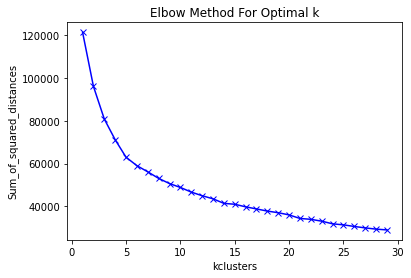

In [50]:
# import k-means from clustering stage
from sklearn.cluster import KMeans

# set number of clusters
kclusters = range(1,30)

Sum_of_squared_distances=[]

for k in kclusters:
    # run k-means clustering
    kmeans = KMeans(n_clusters=k, random_state=0).fit(df_cluster1)
    Sum_of_squared_distances.append(kmeans.inertia_)

# check cluster labels generated for each row in the dataframe
#print(kmeans.labels_)

plt.plot(kclusters, Sum_of_squared_distances, 'bx-')
plt.xlabel('kclusters')
plt.ylabel('Sum_of_squared_distances')
plt.title('Elbow Method For Optimal k')
plt.show()



k=6 seems to be the best

In [51]:
# I choose 6 cluster
kmeans = KMeans(n_clusters=6, random_state=0).fit(df_cluster1)

In [52]:
# i insert the K-Means label in the data frame
df_copy = df_accident
df_copy['CLUSTER_LABEL']=kmeans.labels_
df_cluster1['CLUSTER_LABEL']=kmeans.labels_
# df_copy.insert(0, 'CLUSTER_LABEL', kmeans.labels_)
# df_cluster1.insert(0, 'CLUSTER_LABEL', kmeans.labels_)

Clsuter visualisation

In [53]:
for i in range(6):
    clust = df_cluster1[df_cluster1['CLUSTER_LABEL'] == i]
    print('--------cluster {}-------- '.format(i))
    print(clust.shape)
    print(clust.mean())

--------cluster 0-------- 
(7435, 23)
NB_USAGER         2.036046
NB_VEH            1.010491
NB_PIE            0.955346
NB_VEL            0.021654
NB_CYC            0.068460
NB_MOT            0.132213
NB_VL             0.737458
NB_PL             0.017888
NB_TC             0.032818
DAY               0.357902
NIGHT             0.642098
LETHAL            0.014391
LIGHT             0.802959
SERIOUS           0.182650
CHAIN_COLLI       0.000000
FRONT_COLLI       0.000000
MULTIPLE_COLLI    0.000000
OTHER_COLLI       0.918628
REAR_COLLI        0.000000
SIDE_COLLI        0.000000
WITHOUT_COLLI     0.000134
DRUNK_DRUG        0.002690
CLUSTER_LABEL     0.000000
dtype: float64
--------cluster 1-------- 
(5192, 23)
NB_USAGER         2.116718
NB_VEH            2.015601
NB_PIE            0.000963
NB_VEL            0.015986
NB_CYC            0.021572
NB_MOT            1.029661
NB_VL             0.914099
NB_PL             0.024461
NB_TC             0.009823
DAY               0.000385
NIGHT             

The coolision type takes too much importance so i remove it.
I try another clustering only on the day/minght, severity and type of vehicules involved (including pedestrians)

# second K-Means Analysis

This analysis is based on the number of vehicles, the day/night columns, the severity, and the number of vehicles of each type involved

In [54]:

df_cluster2 = df_light1.drop(['DATE_1','ID_PV','LUMINOSITE','COND_ATMOS','TYPE_COLLI','CAT_ROUTE1', 'TYPE_ACCI', 'ETAT_USA1', 'ETAT_USA2','NB_USAGER','NIGHT_TMP','CHAIN_COLLI', 'FRONT_COLLI', 'MULTIPLE_COLLI', 'OTHER_COLLI','REAR_COLLI', 'SIDE_COLLI', 'WITHOUT_COLLI',],axis=1)

As above, i use the shoulder method to dtermine the best number of clusters

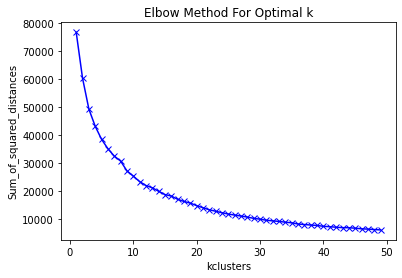

In [55]:

# set number of clusters
kclusters = range(1,50)

Sum_of_squared_distances=[]

for k in kclusters:
    # run k-means clustering
    kmeans = KMeans(n_clusters=k, random_state=0).fit(df_cluster2)
    Sum_of_squared_distances.append(kmeans.inertia_)

# check cluster labels generated for each row in the dataframe
#print(kmeans.labels_)

plt.plot(kclusters, Sum_of_squared_distances, 'bx-')
plt.xlabel('kclusters')
plt.ylabel('Sum_of_squared_distances')
plt.title('Elbow Method For Optimal k')
plt.show()


I keep k=12

In [56]:
#I choose 12 clusters
k=12
kmeans = KMeans(n_clusters=k, random_state=0).fit(df_cluster2)

In [57]:

# check cluster labels generated for each row in the dataframe
print(kmeans.labels_)

df_copy = df_accident
df_copy['CLUSTER_LABEL']=kmeans.labels_
df_cluster2['CLUSTER_LABEL']=kmeans.labels_
# df_copy.insert(0, 'CLUSTER_LABEL', kmeans.labels_)
# df_cluster1.insert(0, 'CLUSTER_LABEL', kmeans.labels_)

[ 0  0  3 ...  5  5 10]


Cluster overview

In [58]:
for i in range(k):
    clust = df_cluster2[df_cluster2['CLUSTER_LABEL'] == i]
    print('--------cluster {}-------- '.format(i))
    print(clust.shape)
    print(clust.mean())

--------cluster 0-------- 
(3364, 15)
NB_VEH           1.869798
NB_PIE           0.002675
NB_VEL           0.020809
NB_CYC           0.024078
NB_MOT           1.003864
NB_VL            0.755648
NB_PL            0.042806
NB_TC            0.022592
DAY              1.000000
NIGHT            0.000000
LETHAL           0.016350
LIGHT            0.983056
SERIOUS          0.000595
DRUNK_DRUG       0.003567
CLUSTER_LABEL    0.000000
dtype: float64
--------cluster 1-------- 
(3873, 15)
NB_VEH           1.885102
NB_PIE           0.002324
NB_VEL           0.227989
NB_CYC           0.719339
NB_MOT           0.022980
NB_VL            0.791376
NB_PL            0.076168
NB_TC            0.047250
DAY              0.007230
NIGHT            0.992770
LETHAL           0.003357
LIGHT            0.994836
SERIOUS          0.001807
DRUNK_DRUG       0.002840
CLUSTER_LABEL    1.000000
dtype: float64
--------cluster 2-------- 
(4032, 15)
NB_VEH           1.002976
NB_PIE           0.805060
NB_VEL           0.02108

# Draw a map of the accident caused by alcohol or drug

In [59]:


df_drunk = df_copy
df_drunk['DRUNK_DRUG']=df_light1['DRUNK_DRUG']

df_drunk.columns
df_drunk=df_drunk[df_drunk['DRUNK_DRUG']==1]

print(df_drunk.shape)

# create map
# address = 'Nanterre, France'

# geolocator = Nominatim(user_agent="Coursera_FinalAssignment")
# location = geolocator.geocode(address)
# latitude = location.latitude
# longitude = location.longitude

map_drunk = folium.Map(location=[latitude, longitude], zoom_start=11)

# set color scheme for the clusters
x = np.arange(k)
ys = [i + x + (i*x)**2 for i in range(k)]
colors_array = cm.rainbow(np.linspace(0, 1, len(ys)))
rainbow = [colors.rgb2hex(i) for i in colors_array]


# instantiate a mark cluster object for the incidents in the dataframe
incidents_clusters1 = plugins.MarkerCluster().add_to(map_drunk)


# add markers to the map
markers_colors = []
for lat, lon, poi, cluster in zip(df_drunk['Latitude'], df_drunk['Longitude'], df_drunk['ID_PV'], df_drunk['CLUSTER_LABEL']):
    label = folium.Popup(str(poi) + ' Cluster ' + str(cluster), parse_html=True)
    folium.CircleMarker(
        [lat, lon],
        radius=5,
        popup=label,
        color=rainbow[cluster-1],
        fill=True,
        fill_color=rainbow[cluster-1],
        fill_opacity=0.7).add_to(incidents_clusters1)

map_drunk

(164, 145)


# Draw a map of the lethal accident 

In [60]:

df_lethal = df_copy[['Latitude','Longitude','ID_PV','CLUSTER_LABEL','NB_CYC']]
df_lethal['LETHAL']=df_light1['LETHAL']

df_lethal=df_lethal[df_lethal['LETHAL']>0]

print(df_lethal.head())

# create map
# address = 'Nanterre, France'

# geolocator = Nominatim(user_agent="Coursera_FinalAssignment")
# location = geolocator.geocode(address)
# latitude = location.latitude
# longitude = location.longitude

map_lethal = folium.Map(location=[latitude, longitude], zoom_start=11)

# set color scheme for the clusters
x = np.arange(k)
ys = [i + x + (i*x)**2 for i in range(k)]
colors_array = cm.rainbow(np.linspace(0, 1, len(ys)))
rainbow = [colors.rgb2hex(i) for i in colors_array]


# instantiate a mark cluster object for the incidents in the dataframe
incidents_clusters2 = plugins.MarkerCluster().add_to(map_lethal)


# add markers to the map
markers_colors = []
for lat, lon, poi, cluster in zip(df_lethal['Latitude'], df_lethal['Longitude'], df_lethal['ID_PV'], df_lethal['CLUSTER_LABEL']):
    label = folium.Popup(str(poi) + ' Cluster ' + str(cluster), parse_html=True)
    folium.CircleMarker(
        [lat, lon],
        radius=5,
        popup=label,
        color=rainbow[cluster-1],
        fill=True,
        fill_color=rainbow[cluster-1],
        fill_opacity=0.7).add_to(incidents_clusters2)

map_lethal

Latitude  Longitude                            ID_PV  CLUSTER_LABEL  \
16   48.881300   2.258845  Sécurité publique 0092051 02672              3   
130  48.892768   2.245227  Sécurité publique 0092999 00029              7   
139  48.934351   2.280023                CRS 0197071 10173              7   
202  48.878390   2.213415  Sécurité publique 0092050 00006              4   
571  48.778370   2.322975  Sécurité publique 0092002 21335              2   

     NB_CYC  LETHAL  
16        0       1  
130       0       1  
139       0       1  
202       0       1  
571       0       1  
